# Part 2: Color channel alignment in the frequency domain

In [13]:
import numpy as np
from PIL import Image
from PIL import ImageFilter
from scipy.ndimage import gaussian_filter
import os
import time
import matplotlib.pyplot as plt

In [14]:
#crop images - top by CROP_PIXELS and side by CROP_PIXELS
def crop(r, g, b, CROP_PIXELS_H, CROP_PIXELS_W):
    #top image is b, then g, then r
    return r[CROP_PIXELS_H:-CROP_PIXELS_H, CROP_PIXELS_W:-CROP_PIXELS_W], g[CROP_PIXELS_H:-CROP_PIXELS_H, CROP_PIXELS_W:-CROP_PIXELS_W], b[CROP_PIXELS_H:-CROP_PIXELS_H, CROP_PIXELS_W:-CROP_PIXELS_W]


In [15]:
#constants
CROP_PIXELS_W = 50
CROP_PIXELS_H = 50

In [16]:
# load each low resolution image 
dir_path = "data/"
images_low_res = []     #color images
filenames = []
for filename in os.listdir(dir_path):
    if filename.endswith('.jpg'):
        filenames.append(filename)
        img_path = os.path.join(dir_path, filename)
        img = Image.open(img_path)
        

        # divide image into blue, green, and red (from top to bottom)
        #store image as float for more precision
        img = np.asarray(img) # note: image is now stored as rows and columns
        #Image.fromarray(img).show()
        img_height = img.shape[0] // 3
        b_boundary = img_height
        g_boundary = b_boundary + img_height
        r_boundary = g_boundary + img_height 

        b = img[0:b_boundary, :]
        g = img[b_boundary:g_boundary, :]
        r = img[g_boundary:r_boundary, :]

        #crop images and stack in color image
        color_img = np.dstack((crop(r,g,b, CROP_PIXELS_H, CROP_PIXELS_W)))
        images_low_res.append(color_img)

print(f"Loaded {len(images_low_res)}  low-res images")

Loaded 6  low-res images


In [17]:
def shift_channel(channel, shift_row, shift_col):
    result = np.zeros_like(channel)
    if shift_row > 0:
        result[shift_row:, :] = channel[:-shift_row, :]
    elif shift_row < 0:
        result[:shift_row, :] = channel[-shift_row:, :]
    else:
        result = channel

    temp_result = np.zeros_like(result)
    if shift_col > 0:
        temp_result[:, shift_col:] = result[:, :-shift_col]
    elif shift_col < 0:
        temp_result[:, :shift_col] = result[:, -shift_col:]
    else:
        temp_result = result

    return temp_result

In [18]:
#Create output directory
directory_name = "part2Images/"

#save images
if not os.path.isdir(directory_name):
    # Create the directory
    os.mkdir(directory_name)
else:
    print("Directory already exist")

In [19]:
# Function to globally normalize a 2D array to the range [0, 1] 
def normalize(data):
    return (data - data.min()) / (data.max() - data.min())

In [20]:
def standardize_data(data):
    """
    Called by cross_correlation() function
    standardize data to have mean=0 and standard_deviation=1
    """
    mean = np.mean(data)
    std = np.std(data)

    return (data - mean) / std

In [21]:
def find_shift_fft(image, reference):
    """
    Returns: displacement height, displacement width
    """
    #Take FFT
    reference = np.fft.fft2(reference)
    image = np.fft.fft2(image)

    #shift for zero freq in center
    reference_shift = np.fft.fftshift(reference)
    image_shift = np.fft.fftshift(image)
    
    shift_image_conj = np.conjugate(image_shift) 
    prod = reference_shift * shift_image_conj

    displacement = np.fft.ifft2(prod)

    orig_height = image.shape[0]
    orig_width = image.shape[1]
    MAX_SHIFT_HEIGHT = orig_height // 4
    MAX_SHIFT_WIDTH = orig_width // 4

    # only allow shifting upto 1/4 of the original size of the image
    max_index = np.unravel_index(np.argmax(np.abs(displacement[:MAX_SHIFT_HEIGHT,:MAX_SHIFT_WIDTH])), displacement[:MAX_SHIFT_HEIGHT,:MAX_SHIFT_WIDTH].shape)
    return max_index[0], max_index[1], displacement

00153v.jpg
Blue base
Final shift red: H 14,W 5
Final shift green: H 7,W 3
Elapsed time: 50.8 milliseconds


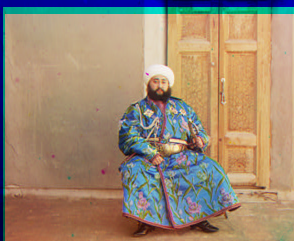

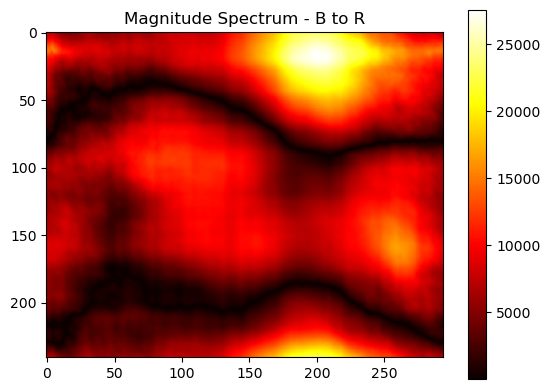

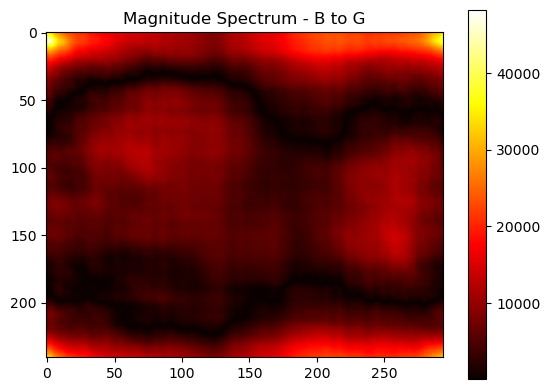

00149v.jpg
Blue base
Final shift red: H 9,W 2
Final shift green: H 4,W 2
Elapsed time: 28.0 milliseconds


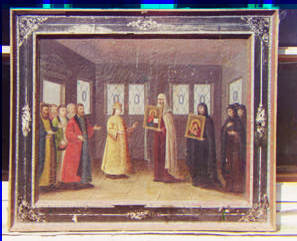

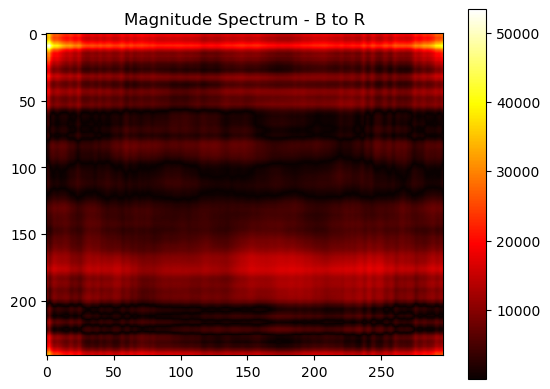

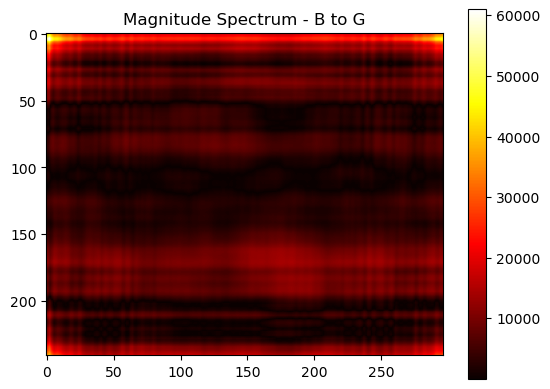

00351v.jpg
Blue base
Final shift red: H 13,W 1
Final shift green: H 4,W 1
Elapsed time: 32.3 milliseconds


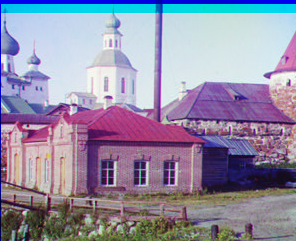

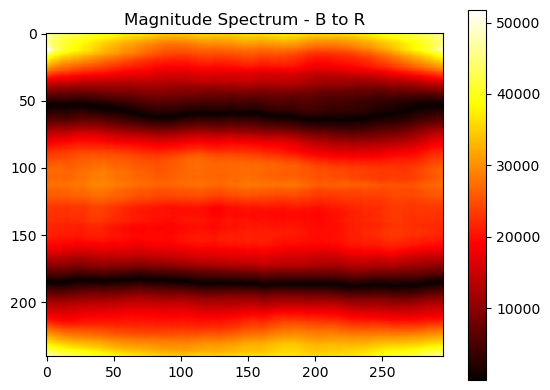

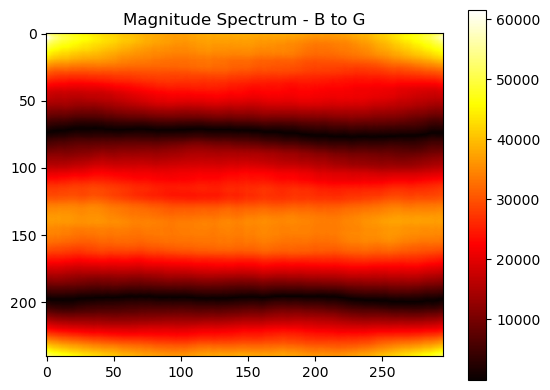

00125v.jpg
Blue base
Final shift red: H 9,W 1
Final shift green: H 5,W 2
Elapsed time: 26.9 milliseconds


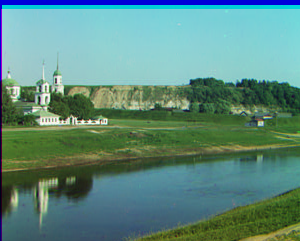

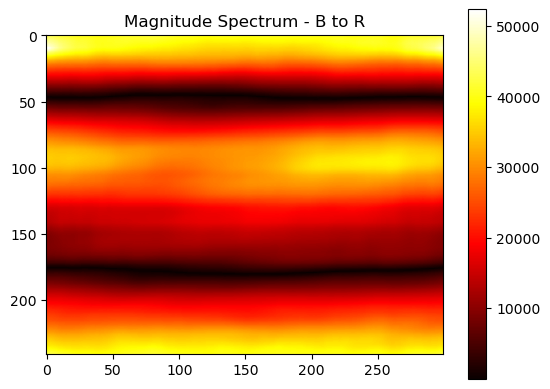

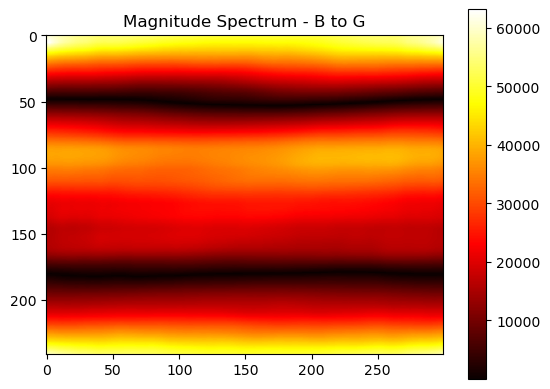

00398v.jpg
Blue base
Final shift red: H 11,W 4
Final shift green: H 5,W 3
Elapsed time: 26.6 milliseconds


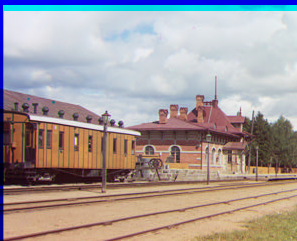

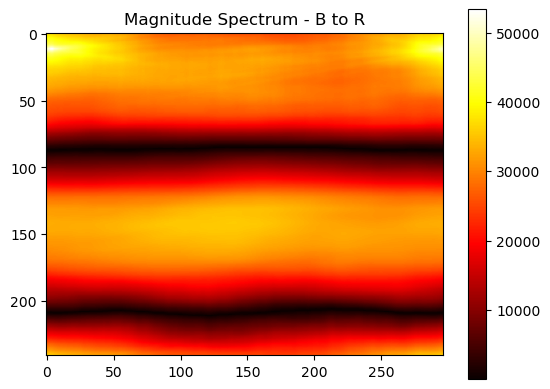

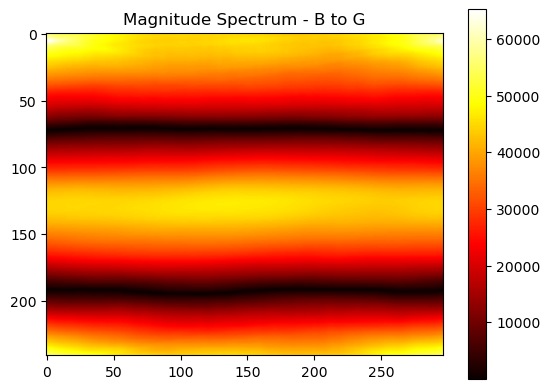

01112v.jpg
Blue base
Final shift red: H 5,W 1
Final shift green: H 0,W 0
Elapsed time: 40.1 milliseconds


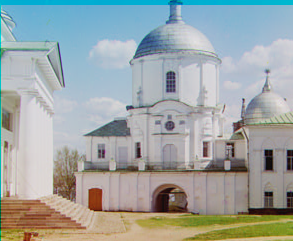

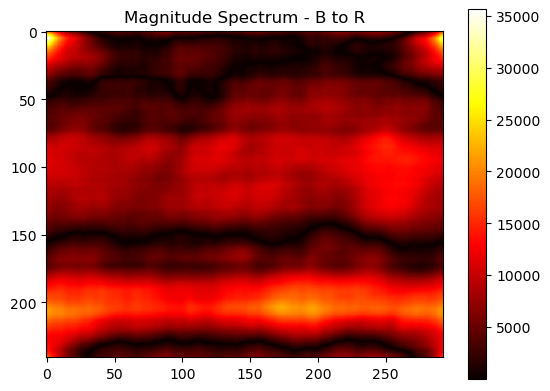

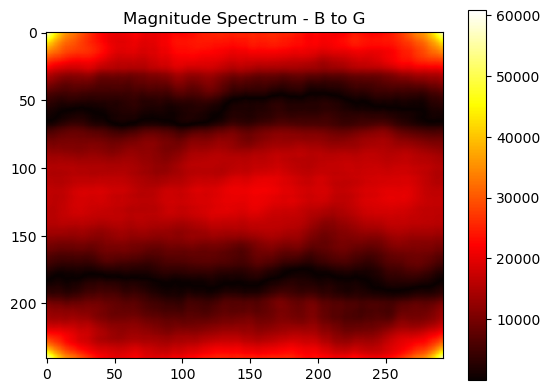

In [22]:
img_num = 0

for image in images_low_res:    
    r_image = image[:,:,0]
    g_image = image[:,:,1]
    b_image = image[:,:,2]

    
    # #standardize each channel
    # r_image_stand = standardize_data(r_image)
    # g_image_stand = standardize_data(g_image)
    # b_image_stand = standardize_data(b_image)

    #normal for unit8
    # max_unit8 = 2**8 -1
    # print(f"max unit16 = {max_unit8}")
    # r_image_norm = max_unit8 * normalize(r_image)
    # g_image_norm = max_unit8 * normalize(g_image)
    # b_image_norm = max_unit8 * normalize(b_image)

    #test standardize
    r_image_norm = standardize_data(r_image.astype(float))
    g_image_norm = standardize_data(g_image.astype(float))
    b_image_norm = standardize_data(b_image.astype(float))
    #end

    #zero pad
    # NUM_ZEROS = 10
    # r_image_norm = np.pad(r_image_norm, pad_width=NUM_ZEROS)
    # g_image_norm = np.pad(g_image_norm, pad_width=NUM_ZEROS)
    # b_image_norm = np.pad(b_image_norm, pad_width=NUM_ZEROS)

    #filter image
    # r_filtered = Image.fromarray(r_image_norm.astype(np.uint8))
    # g_filtered = Image.fromarray(r_image_norm.astype(np.uint8))
    # b_filtered = Image.fromarray(r_image_norm.astype(np.uint8))

    # print("image before")
    # r_filtered.show()
    # print("after")
    # r_filtered.show()
    # FILTER_TYPE = ImageFilter.FIND_EDGES
    # r_filtered = r_filtered.filter(FILTER_TYPE)
    # r_filtered.show()
    # g_filtered = g_filtered.filter(FILTER_TYPE)
    # b_filtered = b_filtered.filter(FILTER_TYPE)

    # #convert back to numpy array
    # r_filtered = np.asarray(r_filtered)
    # g_filtered = np.asarray(g_filtered)
    # b_filtered = np.asarray(b_filtered)
    #end

    #Gaussian filter
    # sigma = 5
    # r_filtered = gaussian_filter(r_image_norm, sigma=sigma, mode='reflect')

    #end

    #compare to green
    # height_shift, width_shift = find_shift_fft(r_image_norm, g_image_norm)
    # print(f"Final shift red: H {height_shift},W {width_shift}")
    # r_shifted = shift_channel(r_image, height_shift, width_shift)

    # height_shift, width_shift = find_shift_fft(b_image_norm, g_image_norm)
    # print(f"Final shift blue: H {height_shift},W {width_shift}")
    # b_shifted = shift_channel(b_image, height_shift, width_shift)
    
    print(filenames[img_num])
    start_time = time.time()

    # compare to blue. BLue seems to work best 
    height_shift, width_shift, inverse_B_to_R  = find_shift_fft(r_image_norm, b_image_norm)
    print("Blue base")
    print(f"Final shift red: H {height_shift},W {width_shift}")
    r_shifted = shift_channel(r_image, height_shift, width_shift)

    height_shift, width_shift, inverse_B_to_G = find_shift_fft(g_image_norm, b_image_norm)
    print(f"Final shift green: H {height_shift},W {width_shift}")
    g_shifted = shift_channel(g_image, height_shift, width_shift)

    end_time = time.time()
    elapsed_time = (end_time - start_time) * 1000
    print(f"Elapsed time: {round(elapsed_time, 1)} milliseconds")

    color_img = np.dstack((r_shifted, g_shifted, b_image))
    #end

    #try with filter
    # height_shift, width_shift = find_shift_fft(r_filtered, b_filtered)
    # print(f"Final shift blue: H {height_shift},W {width_shift}")
    # r_shifted = shift_channel(r_image, height_shift, width_shift)

    # height_shift, width_shift = find_shift_fft(g_filtered, b_filtered)
    # print(f"Final shift green: H {height_shift},W {width_shift}")
    # g_shifted = shift_channel(g_image, height_shift, width_shift)

    # color_img = np.dstack((r_shifted, g_shifted, b_image))
    #end

    # Try with filters
    # height_shift, width_shift = find_shift_fft(r_filtered, g_filtered)
    # print(f"Final shift red: H {height_shift},W {width_shift}")
    # r_shifted = shift_channel(r_image, height_shift, width_shift)

    # height_shift, width_shift = find_shift_fft(b_filtered, g_image_norm)
    # print(f"Final shift green: H {height_shift},W {width_shift}")
    # b_shifted = shift_channel(b_image, height_shift, width_shift)

    #color_img = np.dstack((r_shifted, g_image, b_shifted))

    # covert float to unit8
    # color_img = (color_img) / max_unit16    #convert back to [0, 1] range 
    # color_image_uint8 = (color_img * 255).astype(np.uint8)
    color_img = Image.fromarray(color_img)


    #save images
    color_img.show()
    color_img.save(directory_name + filenames[img_num], format="JPEG")

    #show inverse

    # Compute the magnitude spectrum
    mag_spectrum_BR = np.abs(inverse_B_to_R)
    # Display the magnitude spectrum as a heatmap
    plt.imshow(mag_spectrum_BR, cmap='hot')
    plt.title('Magnitude Spectrum - B to R')
    plt.colorbar()
    plt.savefig(directory_name + filenames[img_num] + 'mag_spec_BR.jpg')
    plt.show()
    
    mag_spectrum_BG = np.abs(inverse_B_to_G)
    plt.imshow(np.abs(mag_spectrum_BG), cmap='hot')
    plt.title('Magnitude Spectrum - B to G')
    plt.colorbar()
    plt.savefig(directory_name + filenames[img_num] + 'mag_spec_BG.jpg')
    plt.show()
    

    img_num += 1


High Res TIFF images

In [23]:
#High res

# load each image 
from PIL import Image

#new way
dir_path = "data_hires/"
images_tif = []     #color images
filenames = []
for filename in os.listdir(dir_path):
    if filename.endswith('.tif'):
        filenames.append(filename)
        img_path = os.path.join(dir_path, filename)
        img = Image.open(img_path)
        #PIL only takes certain data types https://pillow.readthedocs.io/en/stable/reference/Image.html#PIL.Image.fromarray
        #img = np.array(img).astype(float)
        img = np.array(img)

        # divide image into blue, green, and red (from top to bottom)
        # store image as default
     
        #normalize
        #img = normalize(img) 
        #img = standardize_data(img) 

        img_height = img.shape[0] // 3
        b_boundary = img_height
        g_boundary = b_boundary + img_height
        r_boundary = g_boundary + img_height 

        b = img[0:b_boundary, :]
        g = img[b_boundary:g_boundary, :]
        r = img[g_boundary:r_boundary, :]

        # crop
        CROP_PIXELS_H, CROP_PIXELS_W = 450, 450
        r, g, b = crop(r, g, b, CROP_PIXELS_H, CROP_PIXELS_W)
        #Image.fromarray(r.astype(np.uint8)).show()
        # plt.imshow(r, cmap='gray')
        # plt.show()
        # plt.imshow(g, cmap='gray')
        # plt.show()
        # plt.imshow(b, cmap='gray')
        # plt.show()

        #crop images and stack in color image 
        color_img = np.dstack((r,g,b))
        images_tif.append(color_img)

print(f"Loaded {len(images_tif)} high-res images")       
        

Loaded 3 high-res images


01047u.tif
Final shift red: H 71,W 33
Final shift green: H 24,W 20
Elapsed time: 4.6 seconds


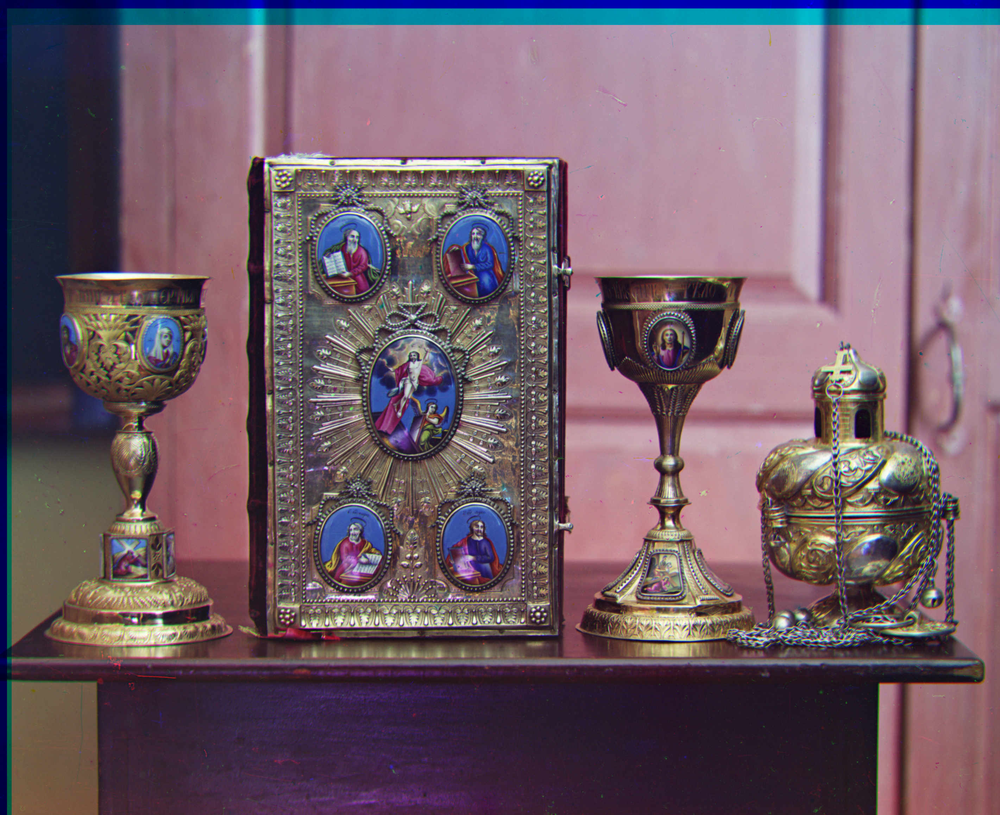

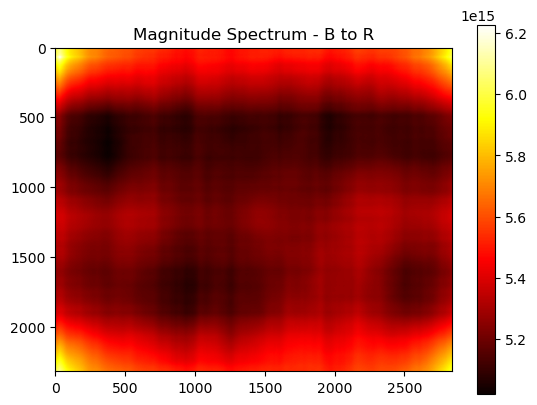

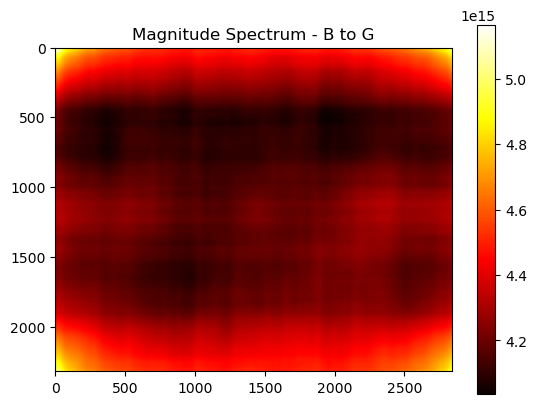

01861a.tif
Final shift red: H 147,W 62
Final shift green: H 71,W 38
Elapsed time: 5.0 seconds


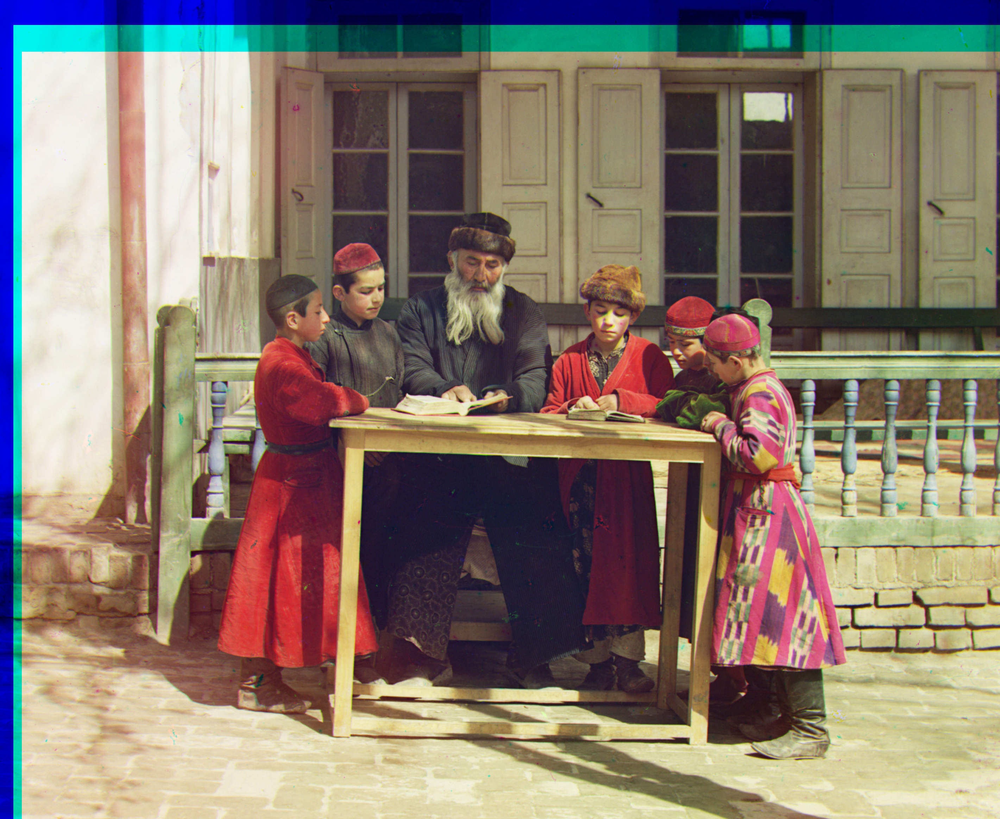

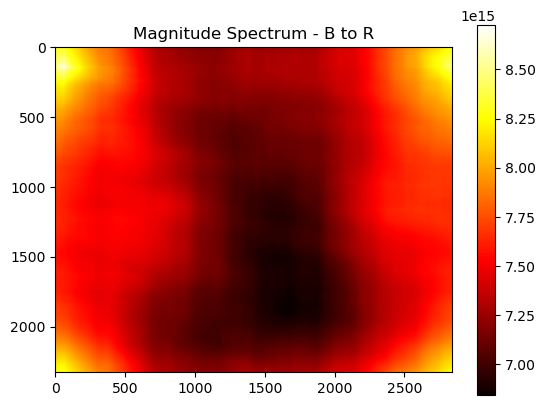

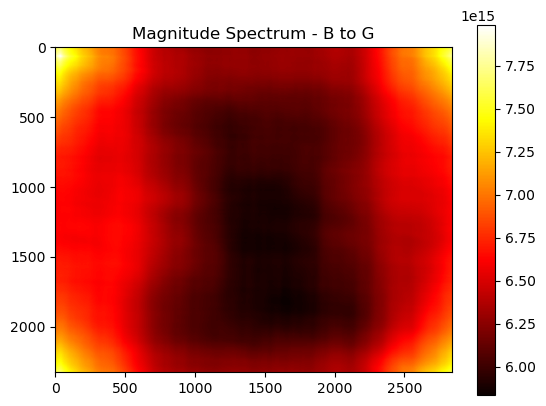

01657u.tif
Final shift red: H 113,W 12
Final shift green: H 52,W 9
Elapsed time: 4.8 seconds


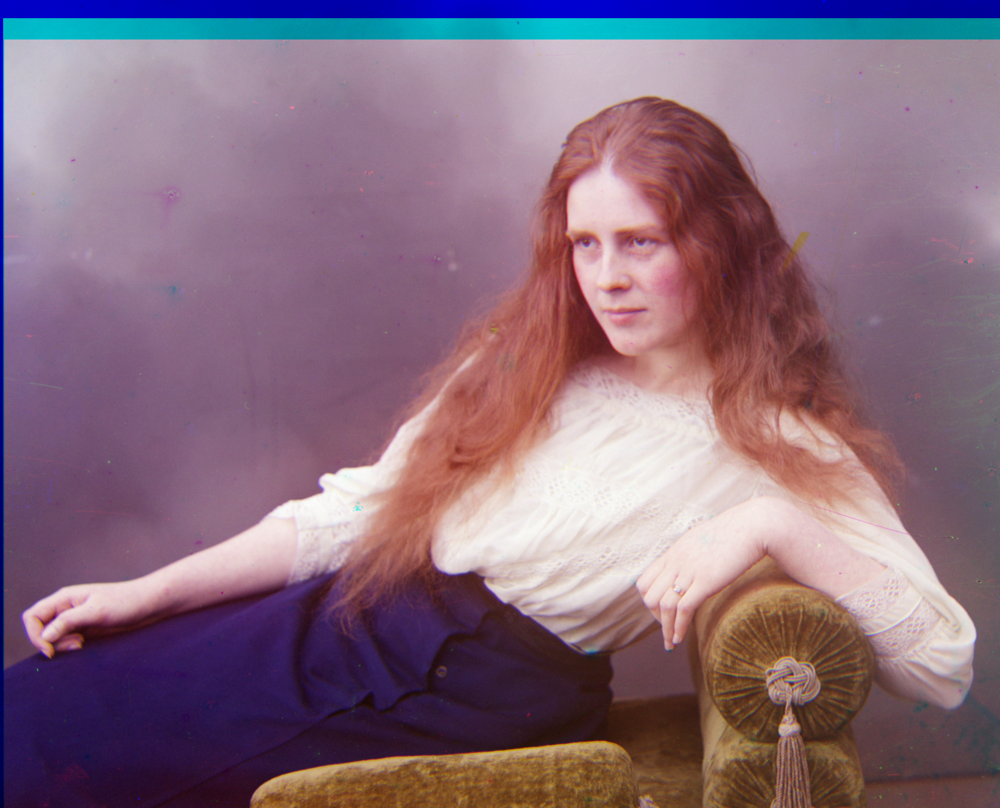

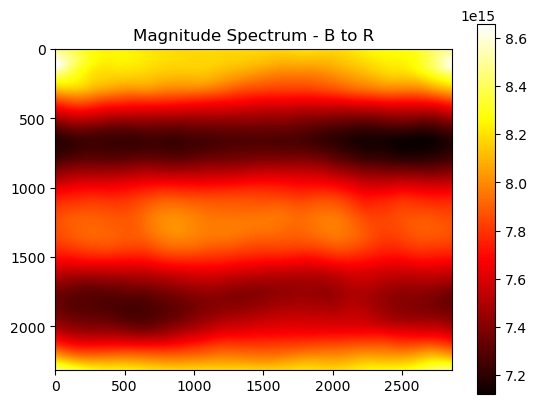

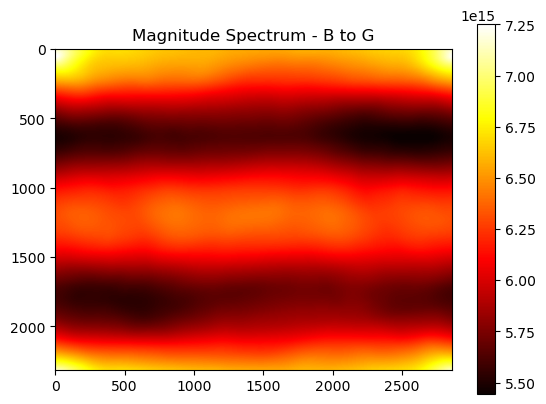

<Figure size 640x480 with 0 Axes>

In [24]:
img_num = 0

for image in images_tif:    
    r_image = image[:,:,0]
    g_image = image[:,:,1]
    b_image = image[:,:,2]

    #normalize
    max_unit16 = 2**16 -1
    
    r_image_norm = max_unit16 * normalize(r_image)
    g_image_norm = max_unit16 * normalize(g_image)
    b_image_norm = max_unit16 * normalize(b_image)
    #end

    print(filenames[img_num])
    start_time = time.time()

    # compare to blue. BLue seems to work best 
    height_shift, width_shift, inverse_B_to_R = find_shift_fft(r_image_norm, b_image_norm)
    print(f"Final shift red: H {height_shift},W {width_shift}")
    r_shifted = shift_channel(r_image_norm, height_shift, width_shift)

    height_shift, width_shift, inverse_B_to_G = find_shift_fft(g_image_norm, b_image_norm)
    print(f"Final shift green: H {height_shift},W {width_shift}")
    g_shifted = shift_channel(g_image_norm, height_shift, width_shift)

    end_time = time.time()
    elapsed_time = (end_time - start_time)
    print(f"Elapsed time: {round(elapsed_time, 1)} seconds")

    color_img = np.dstack((r_shifted, g_shifted, b_image_norm))

    # covert float to unit8
    color_img = (color_img) / max_unit16    #convert to [0, 1] range 
    color_image_uint8 = (color_img * 255).astype(np.uint8)
    color_image_uint8 = Image.fromarray(color_image_uint8)
    
    #save images
    color_image_uint8.show()
    color_image_uint8.save(directory_name + filenames[img_num], format="JPEG")

    #show inverse

    # Compute the magnitude spectrum
    mag_spectrum_BR = np.abs(inverse_B_to_R)
    # Display the magnitude spectrum as a heatmap
    plt.imshow(mag_spectrum_BR, cmap='hot')
    plt.title('Magnitude Spectrum - B to R')
    plt.colorbar()
    plt.show()
    plt.savefig(directory_name + filenames[img_num] + 'mag_spec_BR.jpeg')

    mag_spectrum_BG = np.abs(inverse_B_to_G)
    plt.imshow(np.abs(mag_spectrum_BG), cmap='hot')
    plt.title('Magnitude Spectrum - B to G')
    plt.colorbar()
    plt.show()
    plt.savefig(directory_name + filenames[img_num] + 'mag_spec_BG.jpeg')

    img_num += 1
